# <font color='orange'>RAPP BikeHub Task</font>

## Forecasting bicycle rental duration

**Notebook Overview**:
- Data Preprocessing: Cleanse and preprocess the data to ensure accuracy and consistency, including handling missing values, handling duplicate values, and removing outliers.
- EDA and Feature Engineering: Perform some initial analysis on the dataset by visualising key datapoints. Use correlation coefficients and information gain to determine the most predictive features and refine the dataset accordingly.
- Model Development: Develop a linear regression and random forest regression model to predict bicycle rental duration
- Validation and Fine-Tuning: Evaluate the model's performance using a test dataset, and fine-tune it by adjusting model parameters

## Importing libraries

In [69]:
# data manipulation libraries
import pandas as pd
import numpy as np
from scipy.stats.mstats import winsorize

# data visualisation libraries
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px

# machine learning libraries
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.ensemble import RandomForestRegressor

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.options.mode.chained_assignment = None

## Data preprocessing

### Importing datasets

In [2]:
df_stations = pd.read_csv('../hubway_stations.csv')#
df_trips = pd.read_csv('../hubway_trips.csv')
df_weather = pd.read_csv('../weather.csv')

In [3]:
df_trips.head(5)

,seq_id,hubway_id,status,duration,start_date,strt_statn,end_date,end_statn,bike_nr,subsc_type,zip_code,birth_date,gender
0,1,8,Closed,9,7/28/2011 10:12:00,23.0,7/28/2011 10:12:00,23.0,B00468,Registered,'97217,1976.0,Male
1,2,9,Closed,220,7/28/2011 10:21:00,23.0,7/28/2011 10:25:00,23.0,B00554,Registered,'02215,1966.0,Male
2,3,10,Closed,56,7/28/2011 10:33:00,23.0,7/28/2011 10:34:00,23.0,B00456,Registered,'02108,1943.0,Male
3,4,11,Closed,64,7/28/2011 10:35:00,23.0,7/28/2011 10:36:00,23.0,B00554,Registered,'02116,1981.0,Female
4,5,12,Closed,12,7/28/2011 10:37:00,23.0,7/28/2011 10:37:00,23.0,B00554,Registered,'97214,1983.0,Female


In [4]:
df_stations.head(5)

,id,terminal,station,municipal,lat,lng,status
0,3,B32006,Colleges of the Fenway,Boston,42.340021,-71.100812,Existing
1,4,C32000,Tremont St. at Berkeley St.,Boston,42.345392,-71.069616,Existing
2,5,B32012,Northeastern U / North Parking Lot,Boston,42.341814,-71.090179,Existing
3,6,D32000,Cambridge St. at Joy St.,Boston,42.361285,-71.065140,Existing
4,7,A32000,Fan Pier,Boston,42.353412,-71.044624,Existing


In [5]:
df_weather.head(5)

,STATION,STATION_NAME,ELEVATION,LATITUDE,LONGITUDE,DATE,HPCP,Measurement_Flag,Quality_Flag
0,COOP:190770,BOSTON MA US,3.7,42.3606,-71.0106,20110729 09:00,0.00,T,
1,COOP:190770,BOSTON MA US,3.7,42.3606,-71.0106,20110729 10:00,0.00,T,
2,COOP:190770,BOSTON MA US,3.7,42.3606,-71.0106,20110729 18:00,0.00,T,
3,COOP:190770,BOSTON MA US,3.7,42.3606,-71.0106,20110729 21:00,0.03,,
4,COOP:190770,BOSTON MA US,3.7,42.3606,-71.0106,20110729 22:00,0.04,,


### Merging datasets

In [6]:
# create a new column which is the end timestamp for each trip rounded to the next hour (to be used for joining)
df_trips['rounded_end_date'] = pd.to_datetime(df_trips['end_date']).dt.ceil('H')

In [7]:
# convert the 'DATE' field to a pandas datetime for easier handling
df_weather['DATE'] = pd.to_datetime(df_weather['DATE'])

In [8]:
# remove the 'status' field in the trips dataset as it only contains a single value
df_trips = df_trips.drop('status',axis=1)

In [9]:
# join station data for trip start
raw_data = df_trips.merge(df_stations, left_on='strt_statn', right_on='id', suffixes=(None,'_start'))
raw_data = raw_data.rename(columns=lambda x: x + '_start' if x in df_stations.columns else x)

# join station data for trip end
raw_data = raw_data.merge(df_stations, left_on='end_statn', right_on='id', suffixes=(None,'_end'))
raw_data = raw_data.rename(columns=lambda x: x + '_end' if x in df_stations.columns else x)

According to the documentation, HPCP is "the amount of precipitation recorded at the station for the hour ending at the time specified for DATE". Therefore, I join on rounded end date field so that the weather aligns with the last hour of the bicycle journey. 

In [10]:
# join trip/station data to weather data
raw_data = raw_data.merge(df_weather[['DATE', 'HPCP']], how='left', left_on='rounded_end_date', right_on='DATE')

The documentation also states that "hours with no precipitation are not shown", so I impute the HPCP values with some negative value to indicate no precipitation

In [11]:
# fill nulls in 'HPCP' with -1
raw_data['HPCP'] = raw_data['HPCP'].fillna(-.1) 

# drop the 'DATE' field as this is identical to 'rounded_end_date'
raw_data = raw_data.drop('DATE', axis=1)

In [12]:
def check_nulls_and_duplicates(df):
    # check for empty cells
    empty_cells_proportion = df.isnull().mean()[df.isnull().mean()>0]
    print("Proportion of nulls in columns with missing values:")
    print(empty_cells_proportion)

    # check for duplicates
    duplicates_count = df.duplicated().sum()
    if duplicates_count > 0:
        print(f"\nNumber of duplicate rows found: {duplicates_count}")
    else:
        print("\nNo duplicate rows found")

In [13]:
check_nulls_and_duplicates(raw_data)

Proportion of nulls in columns with missing values:
bike_nr       0.000294
zip_code      0.299402
birth_date    0.777947
gender        0.299303
dtype: float64

No duplicate rows found


## Exploratory data analysis

In [14]:
# set the display format to show 3 decimal place
pd.set_option('display.float_format', lambda x: '%.3f' % x) 

In [255]:
df = raw_data.copy()

### Transforming the target variable

Upon visualising the target variable (duration) I notice it is positively skewed with extreme outliers on both tails. These outliers can significantly skew statistical measures such as mean and standard deviation, leading to inaccurate model representations and biased predictions. I therefore alter the distribution of the target variable using domain knowledge and statistical methods.

In [256]:
px.box(df.duration.sample(10000), x='duration')

In [257]:
# convert duration to minutes
df['duration'] = df['duration']/60

First I define a reasonable range for the number of minutes a bicycle can be hired for. Negative values seem erroneous, and anything less than a minute is unlikely to constitute a meaninful bike hire. I therefore remove rows where the duration is less than 60 seconds. Regarding the upper end of the distribution, I utilise the fact that [Santander bikes can be borrowed for a maximum of 24 hours](https://tfl.gov.uk/corporate/terms-and-conditions/santander-cycles#:~:text=for%20any%20person-,Period%20of%20Use%20and%20Extra%20Ride%20Charges,the%20Maximum%20Period%20of%20Use.), and remove rows where the duration is greater than 1440 minutes.

In [258]:
# remove trips that are less than one minute or more than one day
df = df[(df.duration>=1)&(df.duration<=(24*60))]

I then apply Winsorization to cap values beyond a certain threshold. For example, I cap all durations greater than the 99th percentile to that specific upper limit to prevent them from affecting the model disproportionately.

In [259]:
# set the limits for winsorization (here we cap at 1% quantile at the upper and lower bound)
lower_limit = 0.01
upper_limit = 0.01

# apply winsorization to all columns
target_winsorized = winsorize(df['duration'], limits=(lower_limit, upper_limit))

# replace numerical columns in dataframe with winsorized columns
df['duration'] = target_winsorized

The distribution is now less skewed with fewer outliers

In [260]:
print(df.duration.describe())

count   1570485.000
mean         15.729
std          16.869
min           2.000
25%           7.000
50%          11.000
75%          18.150
max         116.167
Name: duration, dtype: float64


C:\Users\Zain\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\numpy\lib\function_base.py:4650: UserWarning:




In [261]:
px.histogram(df.duration, nbins=100)

### Adding seasonal features


In [262]:
# convert the start and end dates to Pandas datetimes
df.end_date = pd.to_datetime(df.end_date)
df.start_date = pd.to_datetime(df.start_date)

# Extract the year, month, day of week, and hour of day from the end date
df.insert(8,'year', df['end_date'].dt.year)
df.insert(9, 'month', df['end_date'].dt.month)
df.insert(10, 'day', df['end_date'].dt.dayofweek)
df.insert(11, 'hour', df['end_date'].dt.hour)

In [263]:
# remove data for december as there are very few samples most of which are anomalous
df = df[df.month!=12]

In [275]:
months = {
    1:'January',
    2:'February',
    3:'March',
    4:'April',
    5:'May',
    6:'June',
    7:'July',
    8:'August',
    9:'September',
    10:'October',
    11:'November',
    12:'December'
}

fig = px.bar(df.groupby('month')['duration'].mean().rename(months, axis=0), height=500, width=1200)
fig.update_yaxes(title='Average duration (minutes)')
fig.update_xaxes(title='Month')
fig.show()

In [277]:
days_of_week = {
    0:'Monday',
    1:'Tuesday',
    2:'Wednesday',
    3:'Thursday',
    4:'Friday',
    5:'Saturday',
    6:'Sunday'
}

fig = px.bar(df.groupby('day')['duration'].mean().rename(days_of_week, axis=0), height=500, width=1200)
fig.update_yaxes(title='Average duration (minutes)')
fig.update_xaxes(title='Month')
fig.show()

In [278]:
fig = px.bar(df.groupby('hour')['duration'].mean(), height=500, width=1200)
fig.update_yaxes(title='Average duration (minutes)')
fig.update_xaxes(title='Month')
fig.show()

In [201]:
def plot_seasonal_trend(data, timeframe):
    # Calculating the mean and standard deviation
    stats = data.groupby(timeframe)['duration'].agg(['mean', 'std', 'count'])

    # Calculate the 99% confidence interval
    z = 2.576  # Z-value for 99% confidence
    stats['conf_interval'] = z * (stats['std'] / np.sqrt(stats['count']))

    # Prepare the DataFrame for plotting
    stats['lower'] = stats['mean'] - stats['conf_interval']
    stats['upper'] = stats['mean'] + stats['conf_interval']

    # Create a line graph with confidence intervals
    fig = go.Figure([
        go.Scatter(
            x=stats.index, 
            y=stats['mean'], 
            mode='lines',
            name='Average Value',
            line=dict(color='blue'),
        ),
        go.Scatter(
            x=stats.index.tolist() + stats.index[::-1].tolist(),  # x, then x reversed
            y=stats['upper'].tolist() + stats['lower'][::-1].tolist(),  # upper, then lower reversed
            fill='toself',
            fillcolor='rgba(0,100,80,0.2)',
            line=dict(color='rgba(255,255,255,0)'),
            name='Confidence Interval'
        )
    ])
    # Update the layout
    fig.update_layout(
        title='Average Value by Hour with 95% Confidence Intervals',
        xaxis_title='Hour of the Day',
        yaxis_title='Average Value',
        showlegend=True
    )
    # Show the figure
    fig.show()

In [224]:
seasonality_df = df[['year','month_encoded','day_encoded','hour','duration']]
seasonality_df = seasonality_df[seasonality_df.month_encoded!='December']

<Figure size 2000x1000 with 0 Axes>

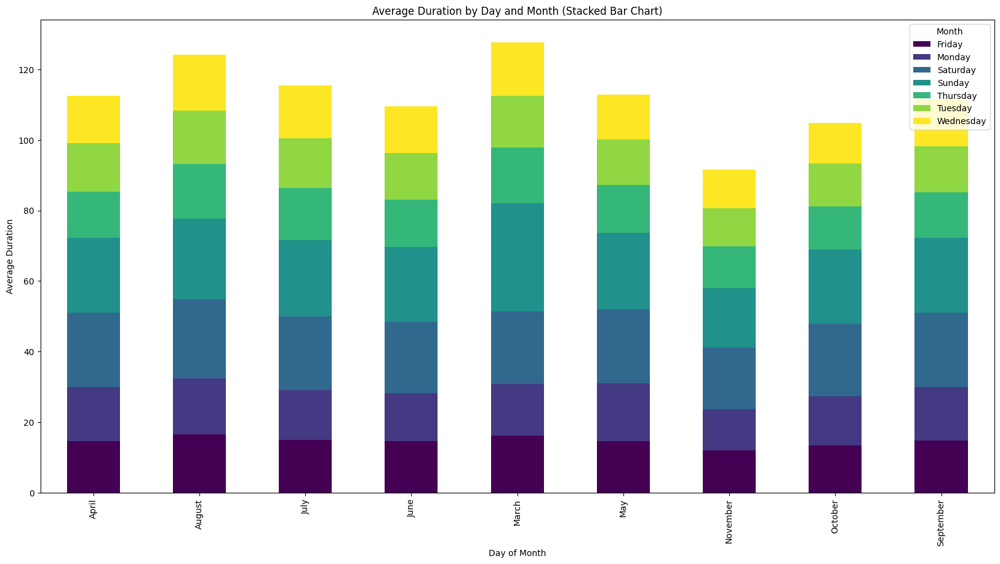

In [279]:
# Aggregate the data to find average duration per day per month
average_duration_per_day = seasonality_df.groupby(['day_encoded','month_encoded'])['duration'].mean().unstack(fill_value=0)

# Transposing to get months in the columns and days as rows
average_duration_per_day = average_duration_per_day.T

# Plotting stacked bar chart
plt.figure(figsize=(20, 10))
average_duration_per_day.plot(kind='bar', stacked=True, colormap='viridis', figsize=(20, 10))
plt.title('Average Duration by Day and Month (Stacked Bar Chart)')
plt.xlabel('Day of Month')
plt.ylabel('Average Duration')
plt.legend(title='Month', loc='upper right')
plt.show()

#### Exploring duration by start station / zip code

In [199]:
temp = df.groupby('terminal_start')['duration'].mean().reset_index()
px.box(temp, x='duration')

In [198]:
temp = df.groupby('station_start')['duration'].mean().reset_index()
px.box(temp, x='duration')

In [194]:
temp = df.groupby('zip_code')['duration'].mean().reset_index()
px.box(temp, x='duration')

#### Create modelling DF

In [114]:
modelling_df = df[['year','month','day','hour','id_start','lat_start','lng_start','HPCP','duration']]

In [115]:
# create a list of our conditions
conditions = [
    (df['HPCP'] > 0),
    (df['HPCP'] <= 0)
]

# create a list of the values we want to assign for each condition
values = [1, 0]

# create a new column and use np.select to assign values to it using our lists as arguments
modelling_df['rain_flag'] = np.select(conditions, values)

In [116]:
modelling_df['registered_user_flag'] = df['subsc_type'].replace({'Casual':0, 'Registered':1})

In [117]:
modelling_df['is_female_flag'] = df['gender'].replace({np.NaN:0, 'Male':0, 'Female':1})
modelling_df['is_male_flag'] = df['gender'].replace({np.NaN:0, 'Male':1, 'Female':0})

In [151]:
modelling_df = pd.concat([modelling_df, pd.get_dummies(df['municipal_start'])], axis=1)

In [153]:
modelling_df = modelling_df[['year', 'month', 'day', 'hour', 'id_start', 'lat_start', 'lng_start', 'HPCP', 'rain_flag', 'registered_user_flag', 
                             'is_female_flag', 'is_male_flag', 'Boston', 'Brookline', 'Cambridge', 'Somerville', 'duration']]

#### Correlation heatmap

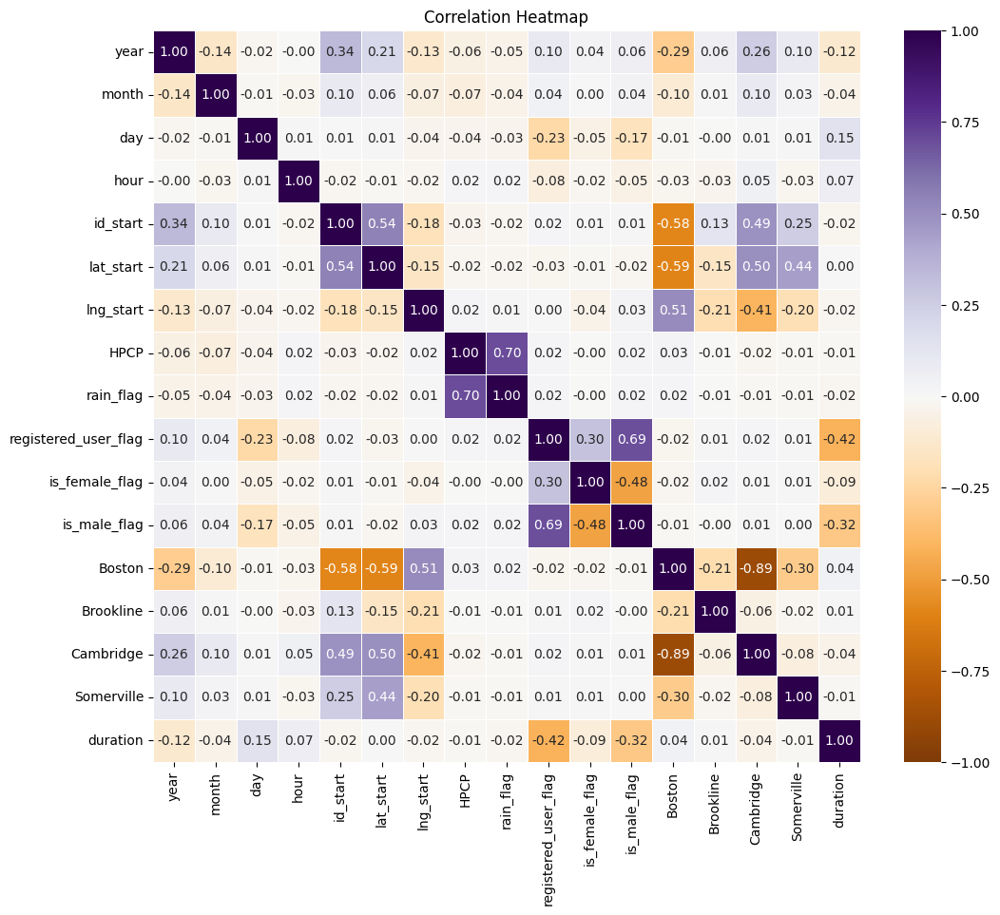

In [154]:
plt.figure(figsize=(12, 10))
sns.heatmap(modelling_df.corr(), annot=True, cmap='PuOr', fmt='.2f', linewidths=0.5, vmin=-1)
plt.title('Correlation Heatmap')
plt.show()

## Modelling

In [171]:
X = modelling_df.drop('duration', axis=1)
y = modelling_df['duration']

In [172]:
# # Perform a chronological split (e.g., 80% train, 20% test)
# train_size = int(0.9 * len(df))
# X_train, X_test = X[:train_size], X[train_size:]
# y_train, y_test = y[:train_size], y[train_size:]

# # Step 5: Create and train the regression model
# model = LinearRegression()
# model.fit(X_train, y_train)

# # Step 6: Predict on test set
# y_pred = model.predict(X_test)

# # Step 7: Evaluate the model
# mse = mean_absolute_percentage_error(y_test, y_pred)
# print(f"MAPE: {mse}")

# # Optionally, display coefficients
# print(f"Model coefficients: {model.coef_}")

In [174]:
# Perform a chronological split (e.g., 80% train, 20% test)
train_size = int(0.9 * len(df))
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]

# Step 5: Create and train the Random Forest Regression model
model = RandomForestRegressor(n_estimators=20, random_state=0)
model.fit(X_train, y_train)

# Step 6: Predict on test set
y_pred = model.predict(X_test)

# Step 7: Evaluate the model
mae = mean_absolute_percentage_error(y_test, y_pred)
print(f"MAPE: {mae}")

mse = mean_squared_error(y_test, y_pred)
print(f"MAPE: {mse}")

# Optionally, display feature importances
print(f"Feature Importances: {model.feature_importances_}")

C:\Users\Zain\AppData\Local\Temp\ipykernel_16016\1108908538.py:4: FutureWarning:

The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.



MAPE: 0.9635346851088832
MAPE: 233.6259428463564
Feature Importances: [0.04933921 0.12551121 0.12081867 0.19224497 0.062135   0.07099744
 0.07406249 0.02440778 0.00366422 0.26987667 0.00140032 0.00141992
 0.00193619 0.00040843 0.00148617 0.00029131]


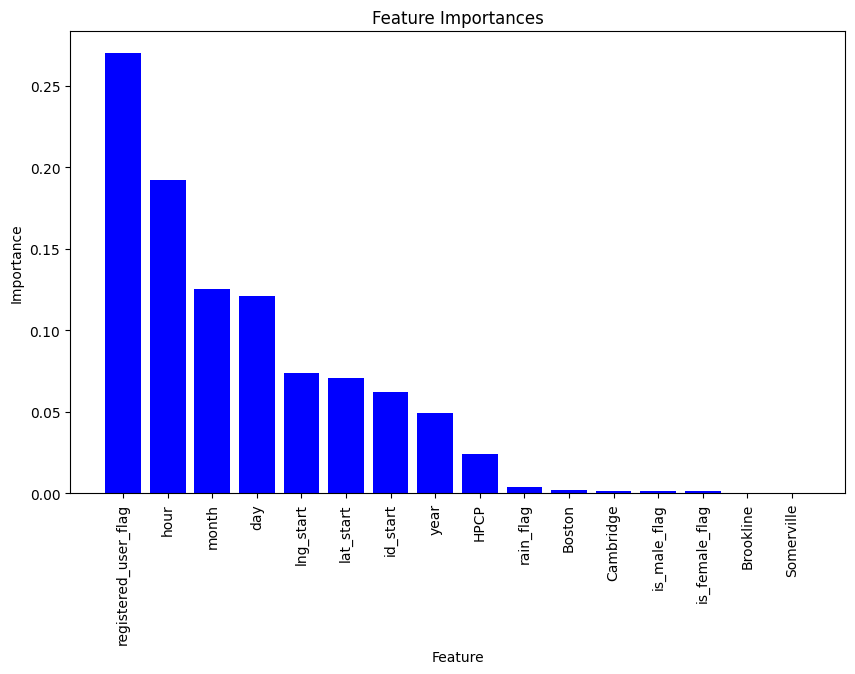

In [178]:
# Feature importances
importances = model.feature_importances_
feature_names = X.columns

# Sort the feature importances in descending order and create arrays
indices = np.argsort(importances)[::-1]

# Plotting
plt.figure(figsize=(10, 6))
plt.title('Feature Importances')
plt.bar(range(len(indices)), importances[indices], color='b', align='center')
plt.xticks(range(len(indices)), [feature_names[i] for i in indices], rotation=90)
plt.xlabel('Feature')
plt.ylabel('Importance')
plt.show()